# Визуализация графика лосса и работы модели

## Визуализация графика лосса

In [21]:
import matplotlib.pyplot as plt
%matplotlib inline
import numpy as np

In [22]:
loss_history = np.loadtxt('train_losses.txt')
mse_history = np.loadtxt('train_mses.txt')
val_mses = np.loadtxt('validation_mses.txt')
n_epochs = len(val_mses)

In [23]:
epoch_len = len(loss_history) // n_epochs

In [24]:
def running_mean(X, n):
    cumsum = np.cumsum(X)
    return (cumsum[n:] - cumsum[:-n]) / n

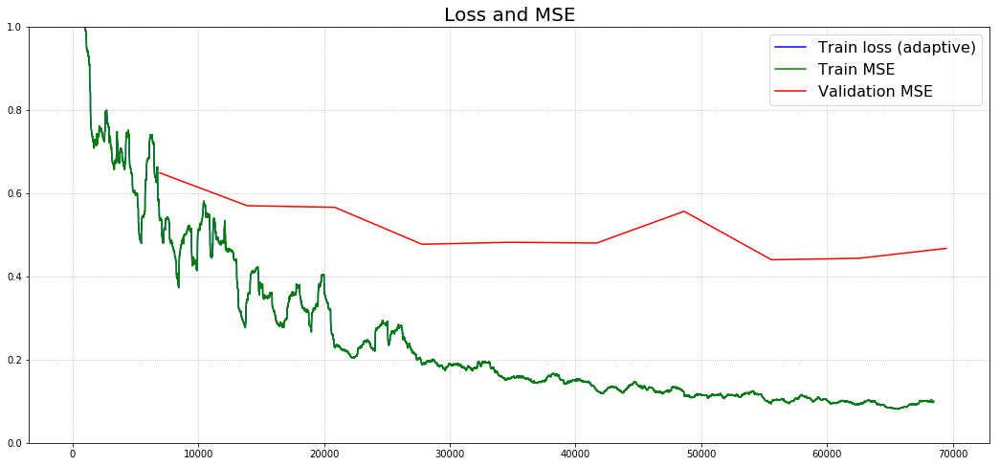

In [27]:
plt.figure(figsize=(18, 8))
plt.title('Loss and MSE', fontsize=20)
plt.grid(ls=':')
plt.plot(running_mean(loss_history, 1000), color='b', label='Train loss (adaptive)')
plt.plot(running_mean(loss_history, 1000), color='g', label='Train MSE')
plt.plot(np.arange(epoch_len, len(loss_history) + epoch_len, epoch_len),
         val_mses, color='r', label='Validation MSE')
plt.ylim((0, 1))
plt.legend(fontsize=16)

Text(0, 0.5, 'k')

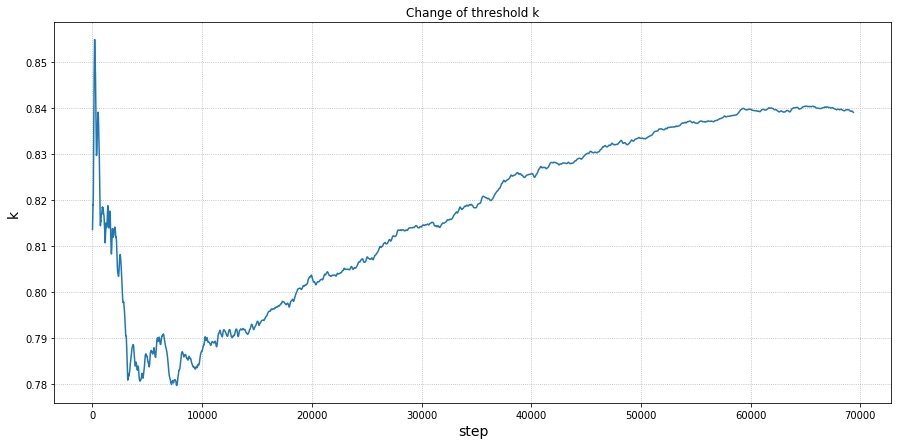

In [28]:
k_history = np.loadtxt('k_history.txt')
plt.figure(figsize=(15, 7))
plt.title('Change of threshold k')
plt.grid(ls=':')
plt.plot(running_mean(k_history, 100))
plt.xlabel('step', fontsize=14)
plt.ylabel('k', fontsize=14)

## Загрузка датасета

In [4]:
import h5py
val_data_file = h5py.File('/home/kmouraviev/NYU_dataset_hdf5/validation_data_different_scenes.hdf5', 'r')
rgbs_val = np.array(val_data_file['data'])
depths_val = np.array(val_data_file['label'])

In [5]:
test_data_file = h5py.File('/home/kmouraviev/NYU_dataset_hdf5/validation_data_different_collections.hdf5', 'r')
rgbs_test = np.array(test_data_file['data'])
depths_test = np.array(test_data_file['label'])

## Визуализация работы модели

In [6]:
import os
os.environ['CUDA_VISIBLE_DEVICES'] = '1'

In [7]:
import sys
sys.path.append('/home/kmouraviev')

In [8]:
from tensorflow_resnet.my_batch_normalization import MyBatchNormalization

Using TensorFlow backend.


In [9]:
from keras.models import load_model
model = load_model('model_on_epoch8.hdf5', custom_objects={'MyBatchNormalization': MyBatchNormalization})

/home/kmouraviev/anaconda/envs/tensorflow_py36_1/lib/python3.6/site-packages/keras/engine/saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


In [10]:
model.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, 384, 512, 3)  0                                            
__________________________________________________________________________________________________
zero_padding2d_1 (ZeroPadding2D (None, 390, 518, 3)  0           input_1[0][0]                    
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 192, 256, 64) 9408        zero_padding2d_1[0][0]           
__________________________________________________________________________________________________
my_batch_normalization_1 (MyBat (None, 192, 256, 64) 256         conv2d_1[0][0]                   
__________________________________________________________________________________________________
activation

### Валидационная выборка: те же коллекции, другие сцены

In [13]:
val_prediction = model.predict(rgbs_val, batch_size=1)
mse = np.mean((val_prediction - depths_val) ** 2)
print('MSE on different scenes:', mse)
rel_error = np.mean(np.abs(val_prediction - depths_val) / np.maximum(depths_val, 0.5))
print('Relative error on different scenes:', rel_error)

MSE on different scenes: 0.4399623030476502
Relative error on different scenes: 0.18447567615287613


In [20]:
val_prediction = np.maximum(val_prediction, 0.5)
depths_val = np.maximum(depths_val, 0.5)
rel_error = np.maximum(val_prediction / depths_val, depths_val / val_prediction)
print('val delta_1:', np.mean(rel_error < 1.25))
print('val delta_2:', np.mean(rel_error < 1.25 ** 2))
print('val delta_3:', np.mean(rel_error < 1.25 ** 3))

val delta_1: 0.7250687491197977
val delta_2: 0.9323593407759316
val delta_3: 0.9827719340397267


In [10]:
def unpreprocess(img):
    img_min = -123
    img_max = 151
    return (img - img_min) / (img_max - img_min)

/home/kmouraviev/anaconda/envs/tensorflow_py36_1/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


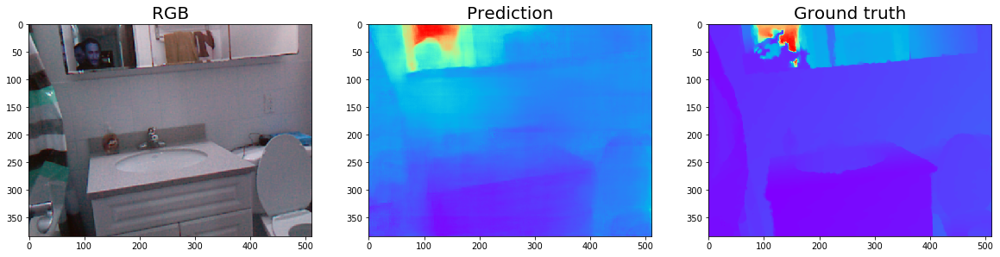

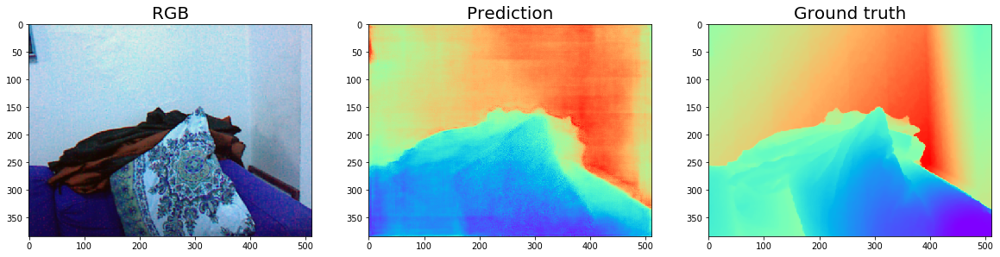

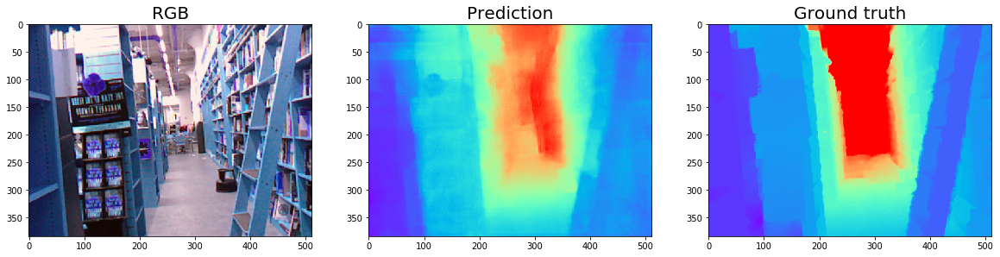

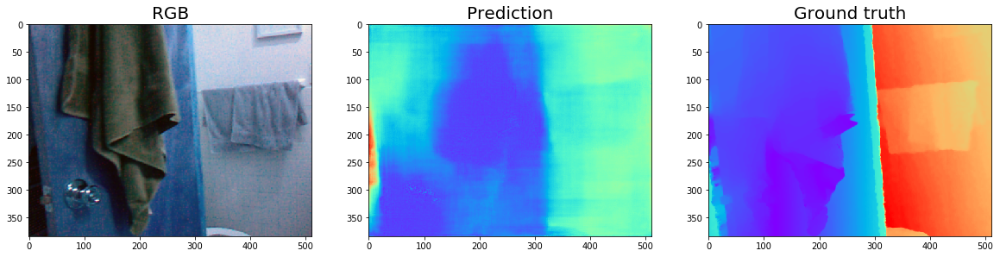

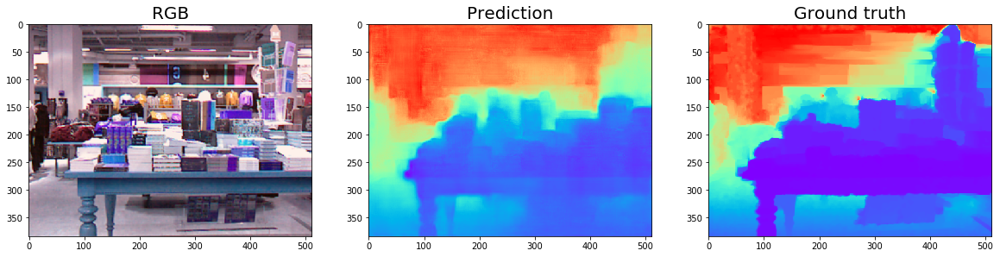

...

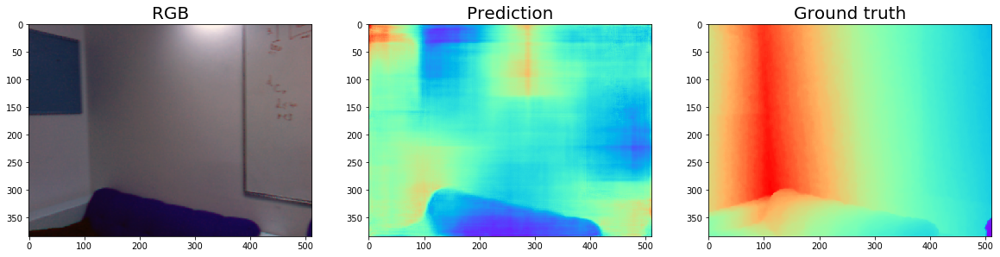

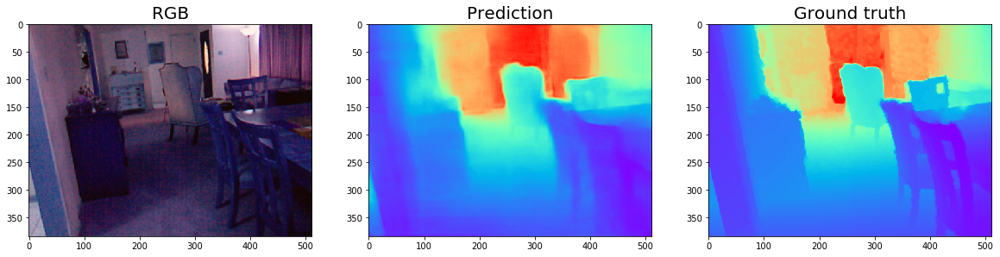

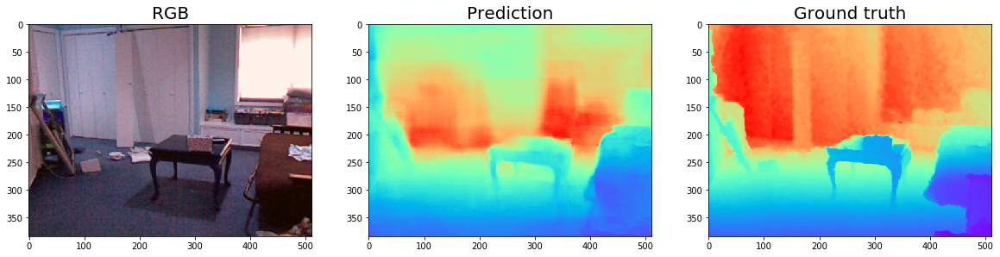

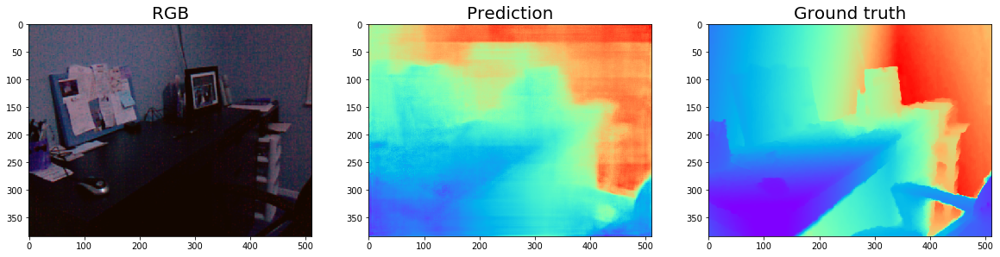

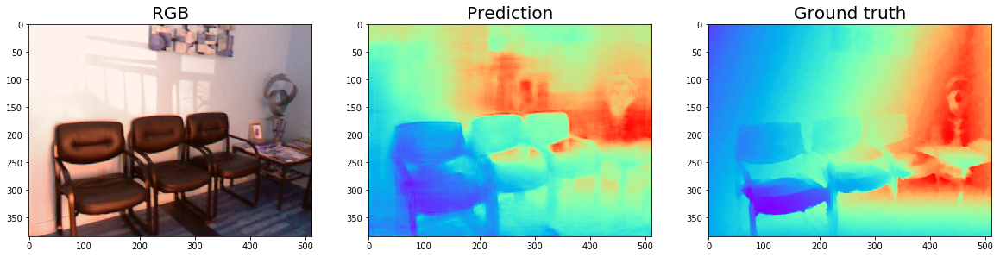

In [11]:
rgbs_val_sample = rgbs_val[::534]
depths_val_sample = depths_val[::534]
val_prediction_sample = model.predict(rgbs_val_sample)
for i in range(len(rgbs_val_sample)):
    plt.figure(figsize=(20, 6))
    plt.subplot(1, 3, 1)
    plt.title('RGB', fontsize=20)
    plt.imshow(unpreprocess(rgbs_val_sample[i]))
    plt.subplot(1, 3, 2)
    plt.title('Prediction', fontsize=20)
    plt.imshow(val_prediction_sample[i] / 10, cmap='rainbow')
    plt.subplot(1, 3, 3)
    plt.title('Ground truth', fontsize=20)
    plt.imshow(depths_val_sample[i] / 10, cmap='rainbow')

In [12]:
error = (val_prediction - depths_val) ** 2
relative_error = np.abs(val_prediction - depths_val) / np.maximum(depths_val, 0.5)
target_pixels = (depths_val < 1)
target_mse = (error * target_pixels).sum() / target_pixels.sum()
target_rel_error = (relative_error * target_pixels).sum() / target_pixels.sum()
print('On objects with depth < 1m:')
print('MSE:', target_mse)
print('Relative_error:', target_rel_error)
print('\n')
target_pixels = np.logical_and(depths_val > 1, depths_val < 2)
target_mse = (error * target_pixels).sum() / target_pixels.sum()
target_rel_error = (relative_error * target_pixels).sum() / target_pixels.sum()
print('On objects with depth between 1m and 2m:')
print('MSE:', target_mse)
print('Relative_error:', target_rel_error)
print('\n')
target_pixels = np.logical_and(depths_val > 2, depths_val < 5)
target_mse = (error * target_pixels).sum() / target_pixels.sum()
target_rel_error = (relative_error * target_pixels).sum() / target_pixels.sum()
print('On objects with depth between 2m and 5m:')
print('MSE:', target_mse)
print('Relative_error:', target_rel_error)
print('\n')
target_pixels = (depths_val > 5)
target_mse = (error * target_pixels).sum() / target_pixels.sum()
target_rel_error = (relative_error * target_pixels).sum() / target_pixels.sum()
print('On objects with depth > 5m:')
print('MSE:', target_mse)
print('Relative_error:', target_rel_error)
print('\n')

On objects with depth < 1m:
MSE: 0.5284955451505573
Relative_error: 0.6007161800460958


On objects with depth between 1m and 2m:
MSE: 0.26233055744950406
Relative_error: 0.2336654240133943


On objects with depth between 2m and 5m:
MSE: 0.3786184996427728
Relative_error: 0.1437522342220652


On objects with depth > 5m:
MSE: 1.5591990690688804
Relative_error: 0.1455720311053296




### Валидационная выборка: другие коллекции

In [14]:
test_prediction = model.predict(rgbs_test, batch_size=16)
mse = np.mean((test_prediction - depths_test) ** 2)
print('MSE on different collections:', mse)
rel_error = np.mean(np.abs(test_prediction - depths_test) / np.maximum(depths_test, 0.5))
print('Relative error on different scenes:', rel_error)

MSE on different collections: 0.6978437268913895
Relative error on different scenes: 0.2300684434982108


In [19]:
test_prediction = np.maximum(test_prediction, 0.5)
depths_test = np.maximum(depths_test, 0.5)
rel_error = np.maximum(test_prediction / depths_test, depths_test / test_prediction)
print('Test delta_1:', np.mean(rel_error < 1.25))
print('Test delta_2:', np.mean(rel_error < 1.25 ** 2))
print('Test delta_3:', np.mean(rel_error < 1.25 ** 3))

Test delta_1: 0.6365298620851463
Test delta_2: 0.8769205348462342
Test delta_3: 0.9617297150832264


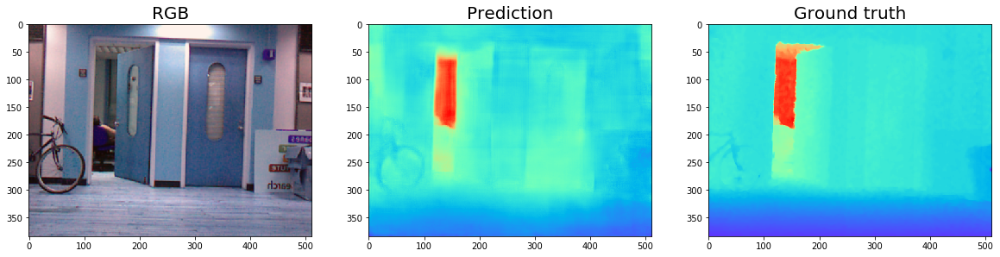

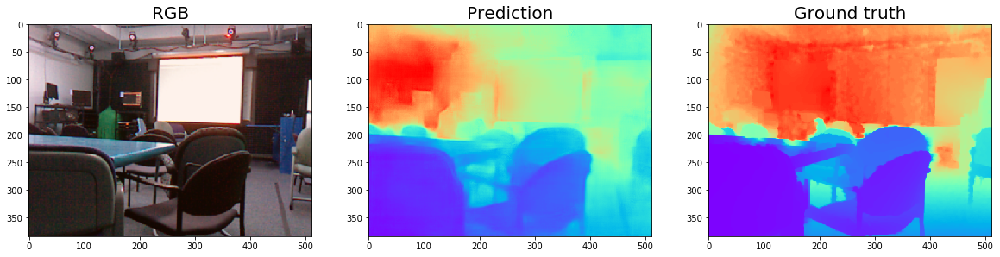

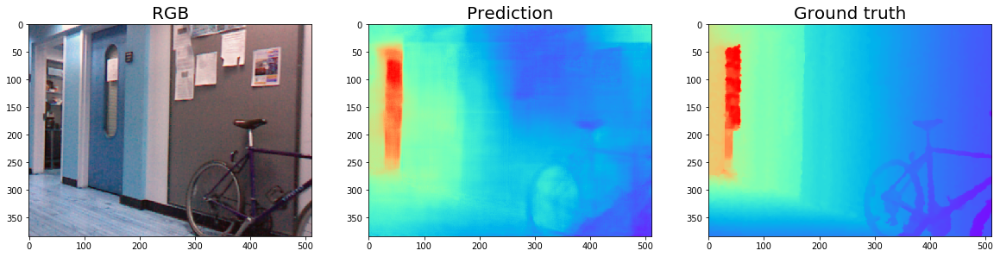

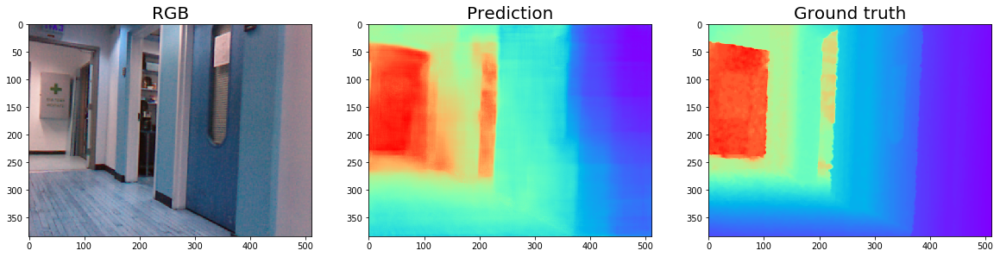

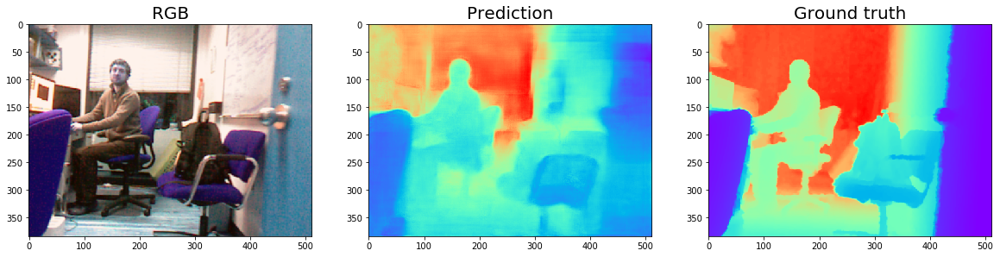

...

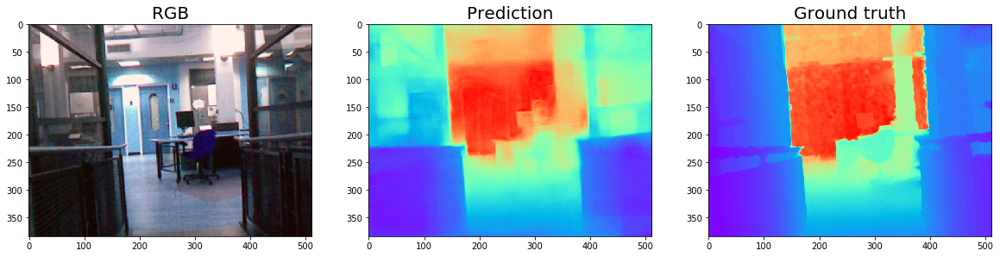

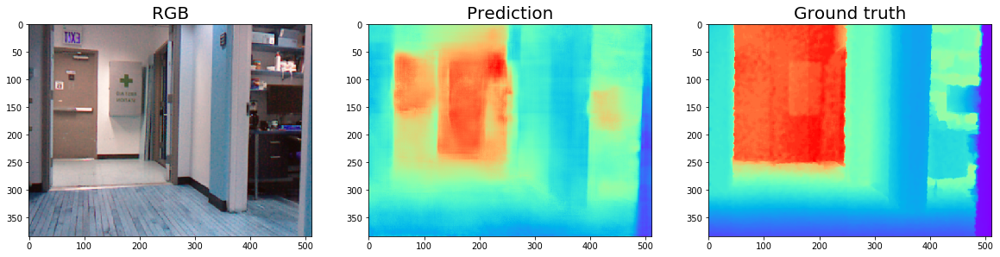

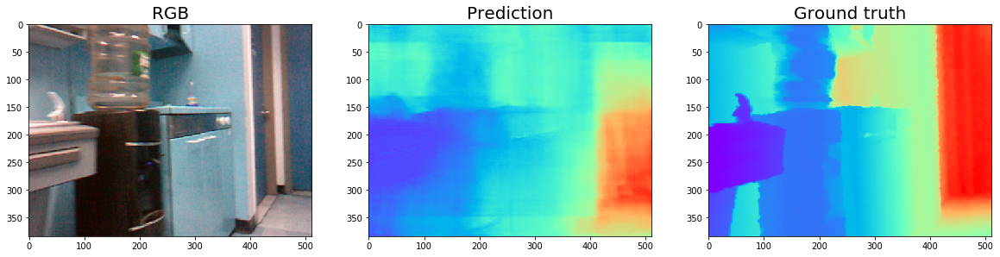

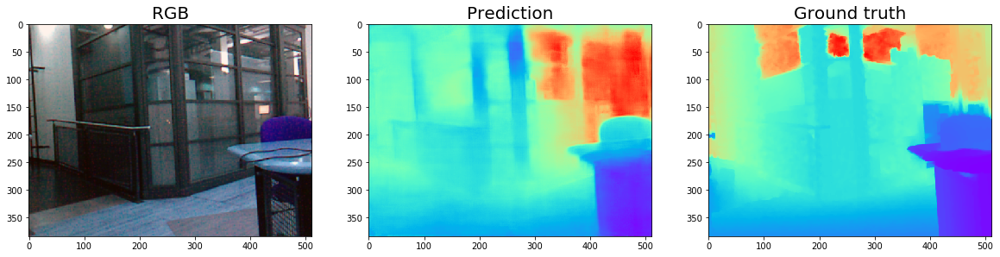

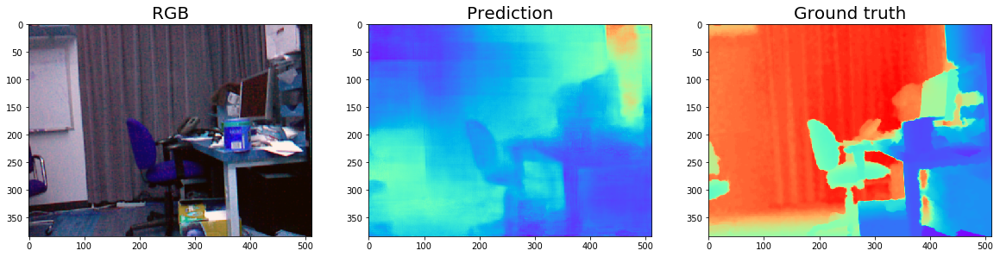

In [14]:
rgbs_test_sample = rgbs_test[::128]
depths_test_sample = depths_test[::128]
test_prediction_sample = model.predict(rgbs_test_sample)
for i in range(len(rgbs_test_sample)):
    plt.figure(figsize=(20, 6))
    plt.subplot(1, 3, 1)
    plt.title('RGB', fontsize=20)
    plt.imshow(unpreprocess(rgbs_test_sample[i]))
    plt.subplot(1, 3, 2)
    plt.title('Prediction', fontsize=20)
    plt.imshow(test_prediction_sample[i] / 10, cmap='rainbow')
    plt.subplot(1, 3, 3)
    plt.title('Ground truth', fontsize=20)
    plt.imshow(depths_test_sample[i] / 10, cmap='rainbow')

In [15]:
error = (test_prediction - depths_test) ** 2
relative_error = np.abs(test_prediction - depths_test) / np.maximum(depths_test, 0.5)
target_pixels = (depths_test < 1)
target_mse = (error * target_pixels).sum() / target_pixels.sum()
target_mse = (error * target_pixels).sum() / target_pixels.sum()
target_rel_error = (relative_error * target_pixels).sum() / target_pixels.sum()
print('On objects with depth < 1m:')
print('MSE:', target_mse)
print('Relative_error:', target_rel_error)
print('\n')
target_pixels = np.logical_and(depths_test > 1, depths_test < 2)
target_mse = (error * target_pixels).sum() / target_pixels.sum()
target_rel_error = (relative_error * target_pixels).sum() / target_pixels.sum()
print('On objects with depth between 1m and 2m:')
print('MSE:', target_mse)
print('Relative_error:', target_rel_error)
print('\n')
target_pixels = np.logical_and(depths_test > 2, depths_test < 5)
target_mse = (error * target_pixels).sum() / target_pixels.sum()
target_rel_error = (relative_error * target_pixels).sum() / target_pixels.sum()
print('On objects with depth between 2m and 5m:')
print('MSE:', target_mse)
print('Relative_error:', target_rel_error)
print('\n')
target_pixels = (depths_test > 5)
target_mse = (error * target_pixels).sum() / target_pixels.sum()
target_rel_error = (relative_error * target_pixels).sum() / target_pixels.sum()
print('On objects with depth > 5m:')
print('MSE:', target_mse)
print('Relative_error:', target_rel_error)
print('\n')

On objects with depth < 1m:
MSE: 0.4166394448139522
Relative_error: 0.6245039259729291


On objects with depth between 1m and 2m:
MSE: 0.3572248059828492
Relative_error: 0.3018592434552188


On objects with depth between 2m and 5m:
MSE: 0.49195660744896813
Relative_error: 0.16987609845478815


On objects with depth > 5m:
MSE: 2.8461974611645013
Relative_error: 0.1874244274930266


